In [1]:
# %%
# Basic imports
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.preprocessing import StandardScaler

In [2]:
# load data
data_path = 'CVD_cleaned.csv'  # replace with your filepath
# Read the data
df = pd.read_csv(data_path)
print('Shape:', df.shape)
df.columns.to_list()
df


Shape: (308854, 19)


,General_Health,Checkup,Exercise,Heart_Disease,Skin_Cancer,Other_Cancer,Depression,Diabetes,Arthritis,Sex,Age_Category,Height_(cm),Weight_(kg),BMI,Smoking_History,Alcohol_Consumption,Fruit_Consumption,Green_Vegetables_Consumption,FriedPotato_Consumption
0,Poor,Within the past 2 years,No,No,No,No,No,No,Yes,Female,70-74,150.0,32.66,14.54,Yes,0.0,30.0,16.0,12.0
1,Very Good,Within the past year,No,Yes,No,No,No,Yes,No,Female,70-74,165.0,77.11,28.29,No,0.0,30.0,0.0,4.0
2,Very Good,Within the past year,Yes,No,No,No,No,Yes,No,Female,60-64,163.0,88.45,33.47,No,4.0,12.0,3.0,16.0
3,Poor,Within the past year,Yes,Yes,No,No,No,Yes,No,Male,75-79,180.0,93.44,28.73,No,0.0,30.0,30.0,8.0
4,Good,Within the past year,No,No,No,No,No,No,No,Male,80+,191.0,88.45,24.37,Yes,0.0,8.0,4.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
308849,Very Good,Within the past year,Yes,No,No,No,No,No,No,Male,25-29,168.0,81.65,29.05,No,4.0,30.0,8.0,0.0
308850,Fair,Within the past 5 years,Yes,No,No,No,No,Yes,No,Male,65-69,180.0,69.85,21.48,No,8.0,15.0,60.0,4.0
308851,Very Good,5 or more years ago,Yes,No,No,No,Yes,"Yes, but female told only during pregnancy",No,Female,30-34,157.0,61.23,24.69,Yes,4.0,40.0,8.0,4.0
308852,Very Good,Within the past year,Yes,No,No,No,No,No,No,Male,65-69,183.0,79.38,23.73,No,3.0,30.0,12.0,0.0


In [3]:
#Note: since this is already cleaned data I did not include any cleaning, imputing etc. there is no missing data


Numeric summary:
                                 count        mean        std    min     25%  \
Alcohol_Consumption           308854.0    5.096366   8.199763   0.00    0.00   
BMI                           308854.0   28.626211   6.522323  12.02   24.21   
FriedPotato_Consumption       308854.0    6.296616   8.582954   0.00    2.00   
Fruit_Consumption             308854.0   29.835200  24.875735   0.00   12.00   
Green_Vegetables_Consumption  308854.0   15.110441  14.926238   0.00    4.00   
Height_(cm)                   308854.0  170.615249  10.658026  91.00  163.00   
Weight_(kg)                   308854.0   83.588655  21.343210  24.95   68.04   

                                 50%     75%     max  
Alcohol_Consumption             1.00    6.00   30.00  
BMI                            27.44   31.85   99.33  
FriedPotato_Consumption         4.00    8.00  128.00  
Fruit_Consumption              30.00   30.00  120.00  
Green_Vegetables_Consumption   12.00   20.00  128.00  
Height_(cm)

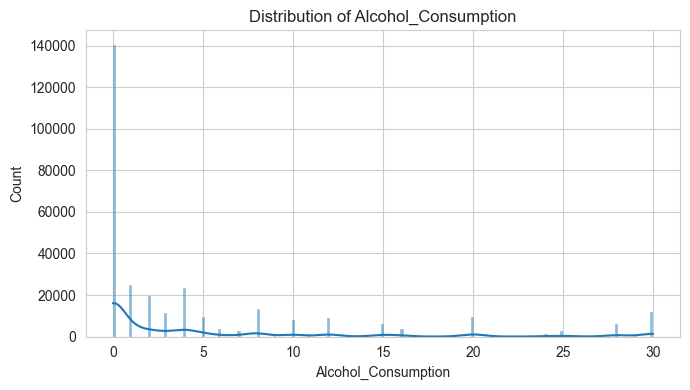

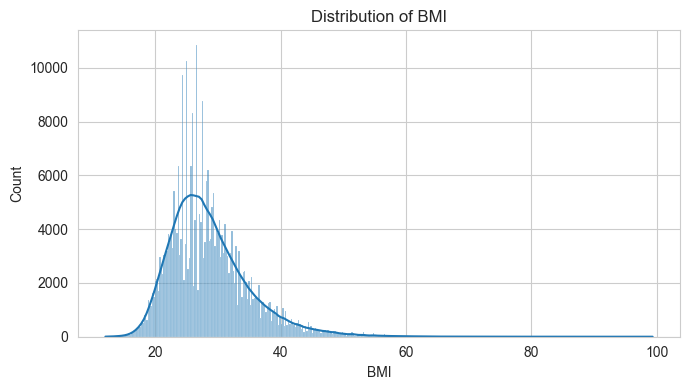

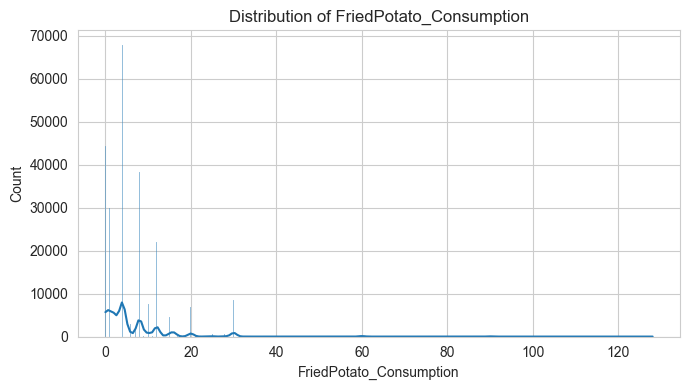

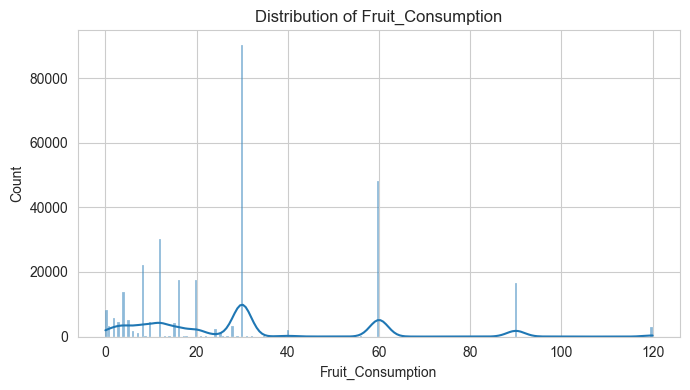

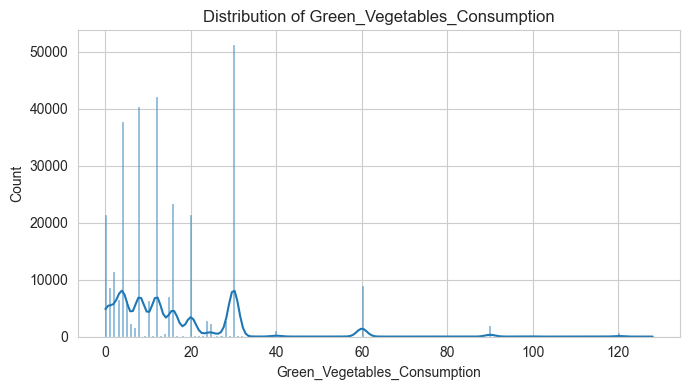

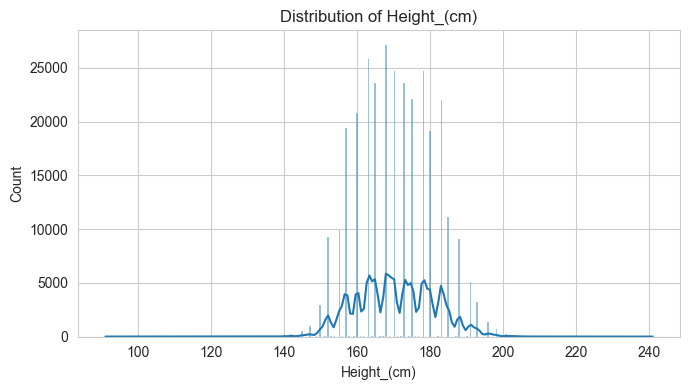

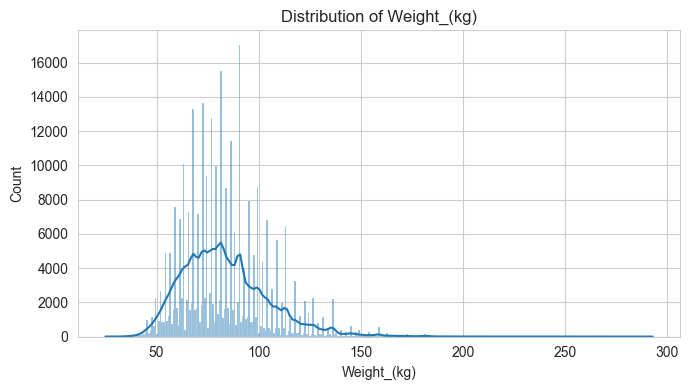

In [4]:
## 2) Summary statistics & distributions
# simple distributions and info on the data, not sure if i would put them in, but see later same info VISUALIZATION 3
# Numeric summaries
numeric_cols = df.select_dtypes(include=['float64']).columns.sort_values()

print('\nNumeric summary:')
print(df[numeric_cols].describe().T)

# Categorical summaries
cat_cols = df.select_dtypes(include=['object']).columns.sort_values()

for c in cat_cols:
    if c in df.columns:
        print(f"\nValue counts for {c}:")
        print(df[c].value_counts(dropna=False))

# Histograms
for c in numeric_cols:
    if c in df.columns:
        plt.figure(figsize = (7,4))
        sns.histplot(df[c].dropna(), kde=True)
        plt.title(f'Distribution of {c}')
        plt.tight_layout()


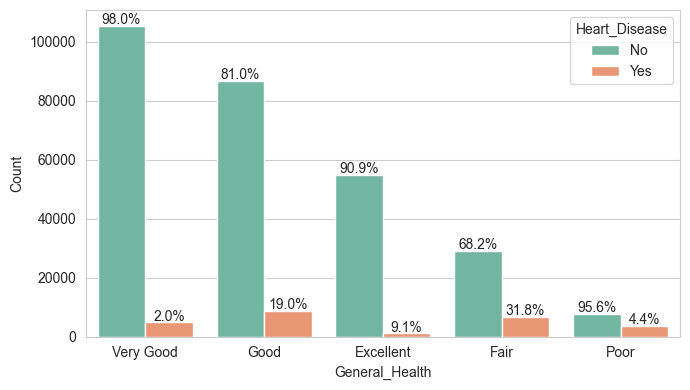

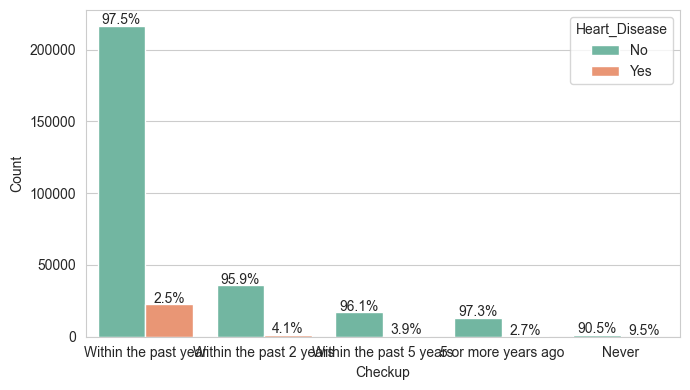

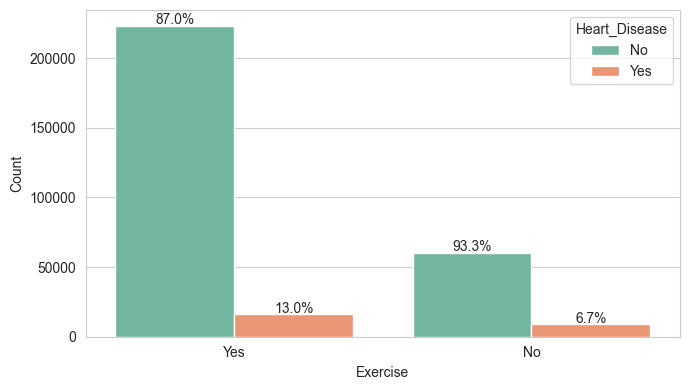

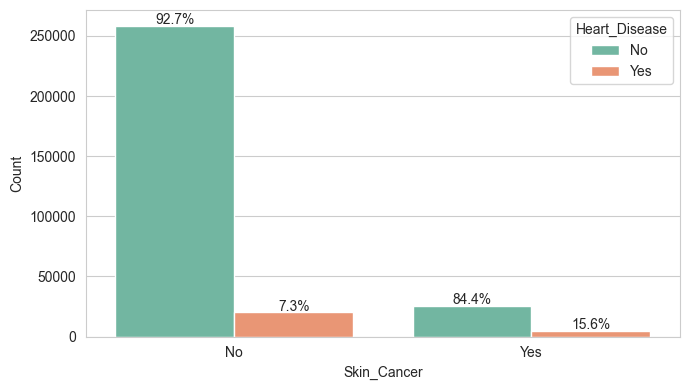

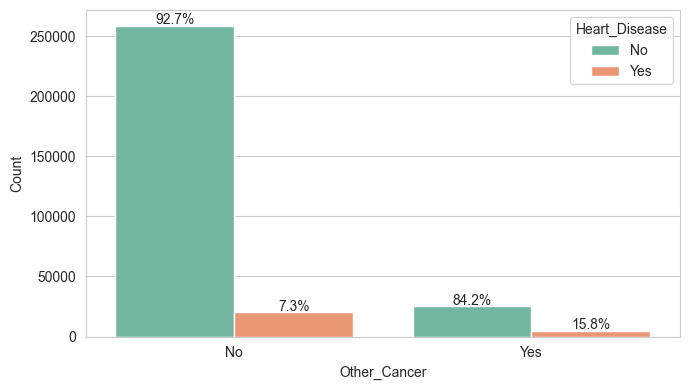

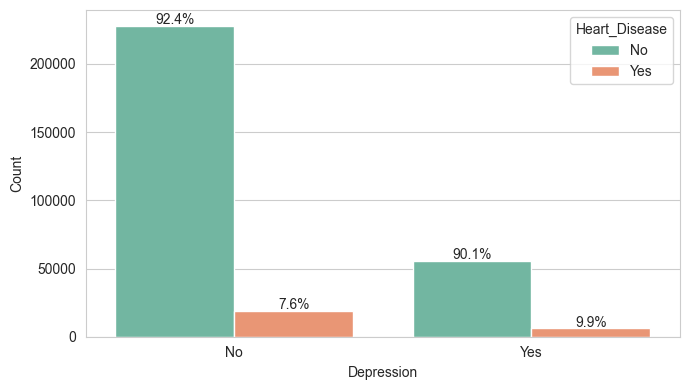

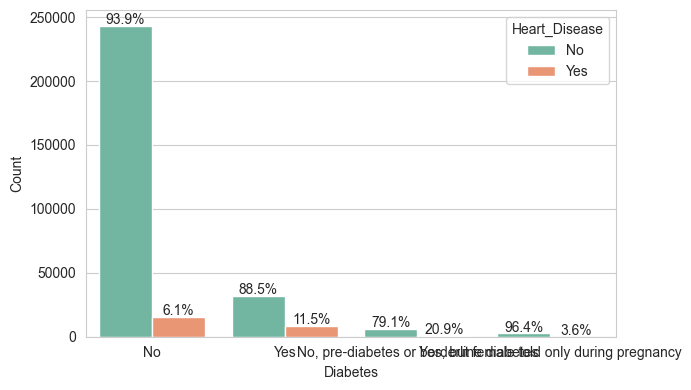

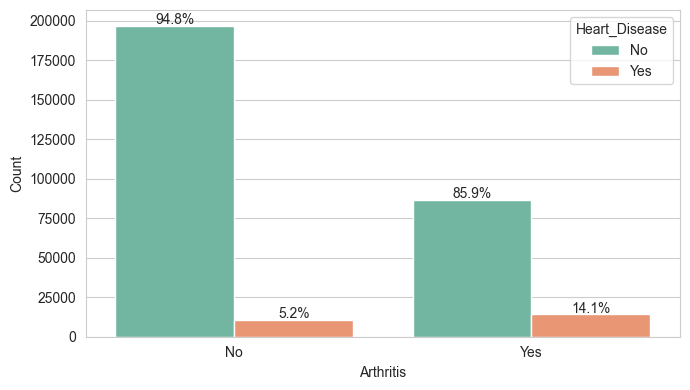

In [5]:
# VISUALIZATION 1: ONE CATEGORIAL VARIABLE VALUES LOOKED WITH HEART DISEASE VS NO HEART DISEASE
for col in ['General_Health',
 'Checkup',
 'Exercise',
 'Skin_Cancer',
 'Other_Cancer',
 'Depression',
 'Diabetes',
 'Arthritis',
 ]:

    trg = 'Heart_Disease'

    fig, ax = plt.subplots(figsize=(7,4))
    color = 'Set2'
    sns.countplot(x=col, data=df, hue=trg, palette=color, order=df[col].value_counts().index, ax=ax)
    ax.set_ylabel('Count')
    offset = df[col].value_counts().max() * 0.005

    bars = ax.patches
    bars_pos = 0
    counts = df.groupby([col, trg])[col].agg('count').unstack().fillna(0).values

    for i in range(df[trg].nunique()):
        for j in range(df[col].nunique()):
            vals = counts[j]
            total = vals.sum()
            count = vals[i]
            pct = count / total if total != 0 else 0
            if pct != 0:
                x = bars[bars_pos].get_x() + bars[bars_pos].get_width()/2
                y = bars[bars_pos].get_height() + offset
                ax.annotate(f'{pct*100:.1f}%', (x, y), ha='center')
                bars_pos += 1

    plt.tight_layout()
    plt.show()

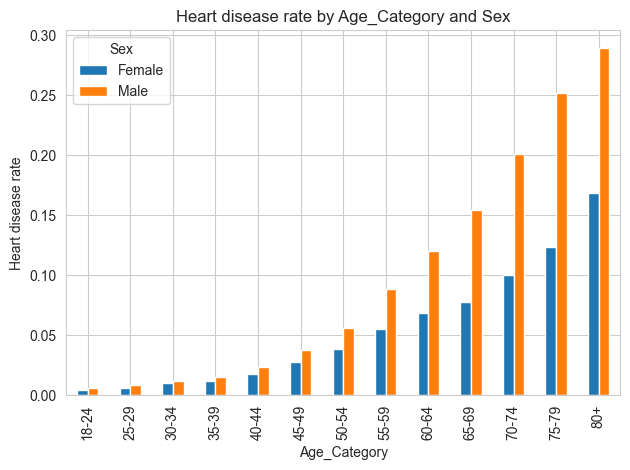

In [6]:
# VISUALIZATION 2: TWO CATEGORICAL VARS VS HEART DIS/NO HEART DIS
# here basically any categorical variable can be chosen and compared for choice1 and choice2 -> so maybe an interactive option to choose these two and observe the heart_disease rate
choice1 = 'Age_Category'
choice2 = 'Sex'
df['Heart_Disease'] = df['Heart_Disease'].map({'Yes':1, 'No':0})

if choice1 in df.columns and choice2 in df.columns and 'Heart_Disease' in df.columns:
    pivot = df.groupby([choice1,choice2])['Heart_Disease'].mean().unstack()
    pivot.plot(kind='bar')
    plt.ylabel('Heart disease rate')
    plt.title(f'Heart disease rate by {choice1} and {choice2}')
    plt.tight_layout()
    plt.show()

# plotting all, but there are too many and ofc not everything makes sense. though we can have them as options to represent

# for choice1 in cat_cols:
#     for choice2 in cat_cols:
#
#         if choice1 in df.columns and choice2 in df.columns and 'Heart_Disease' in df.columns:
#             pivot = df.groupby([choice1,choice2])['Heart_Disease'].mean().unstack()
#             pivot.plot(kind='bar')
#             plt.ylabel('Heart disease rate')
#             plt.title(f'Heart disease rate by {choice1} and {choice2}')
#             plt.tight_layout()
#             plt.show()

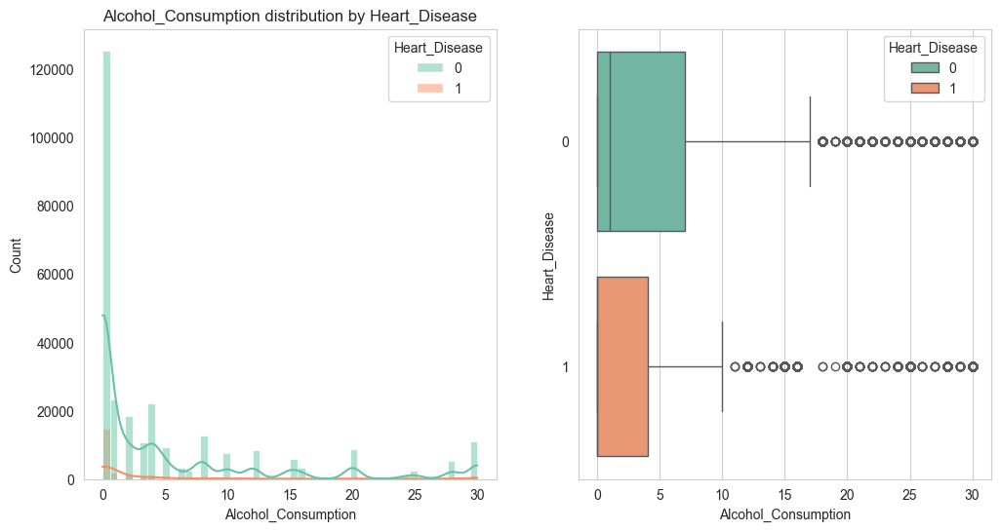

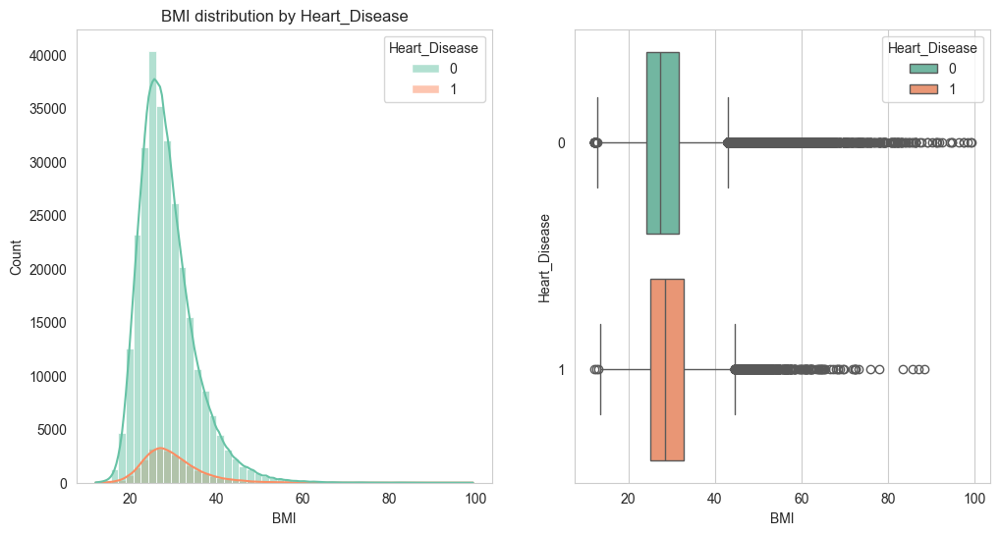

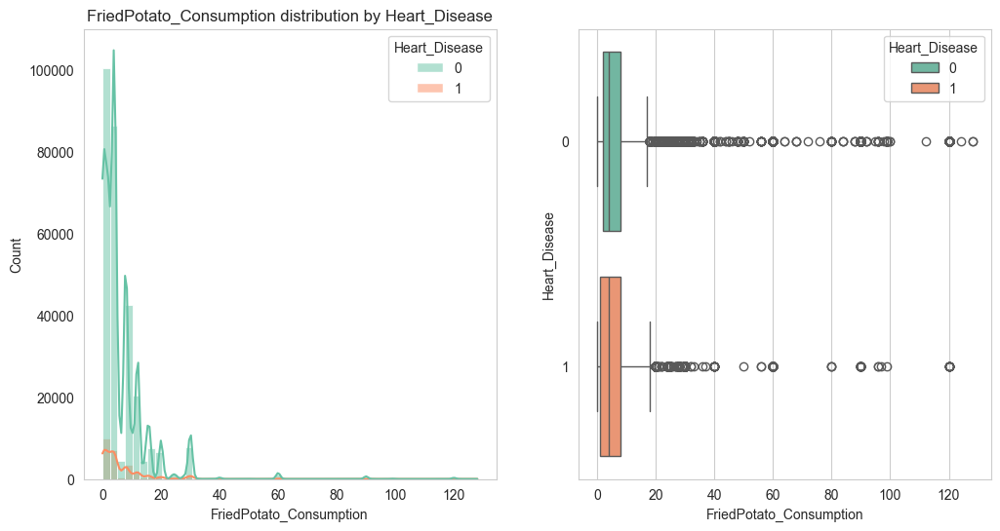

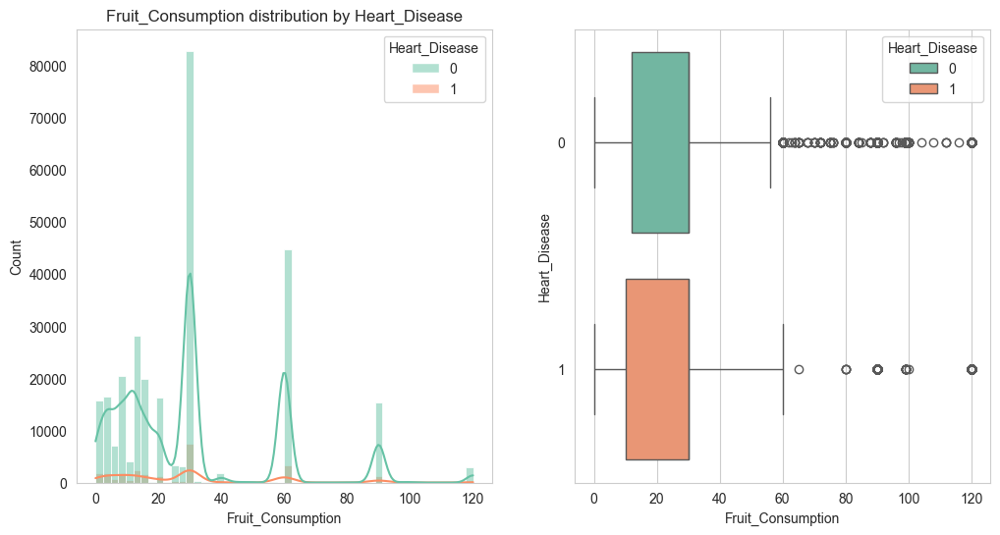

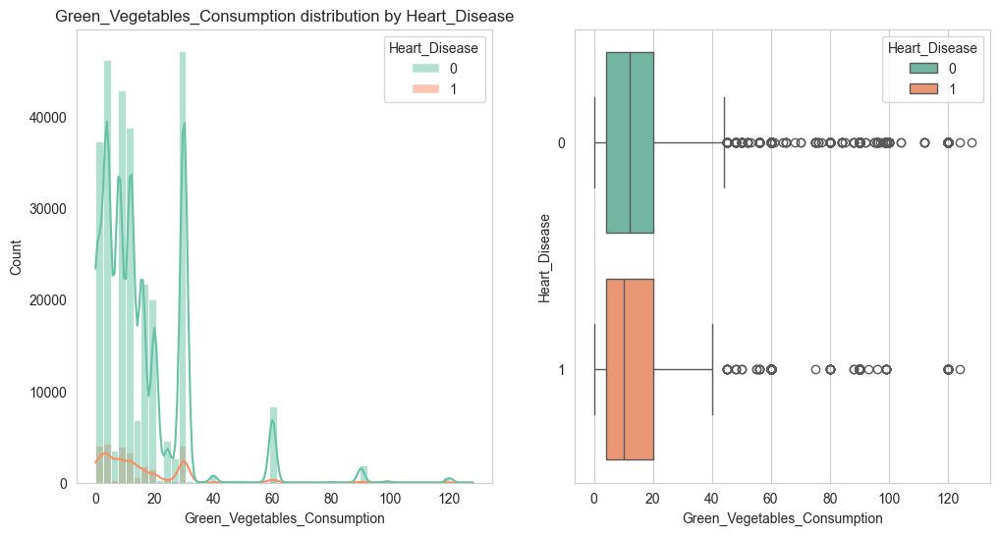

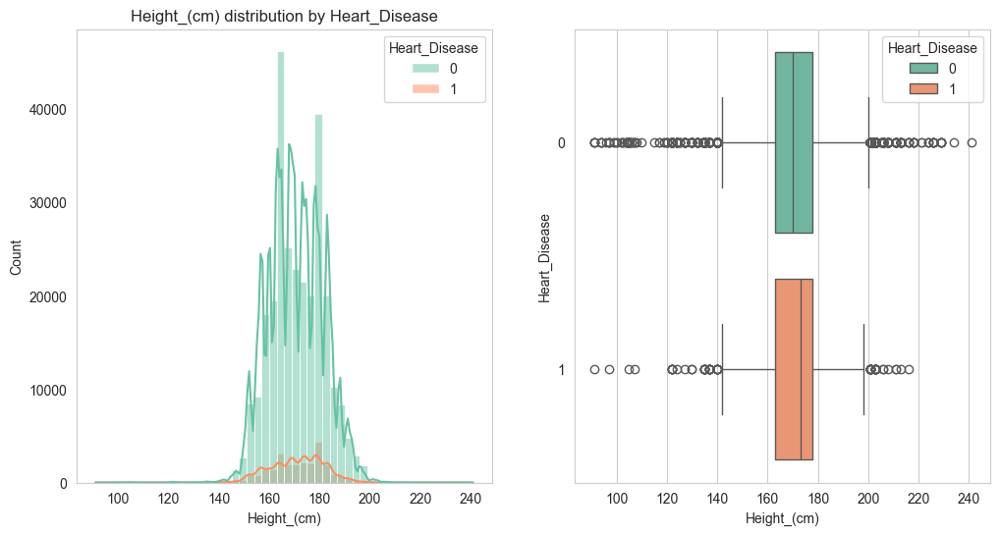

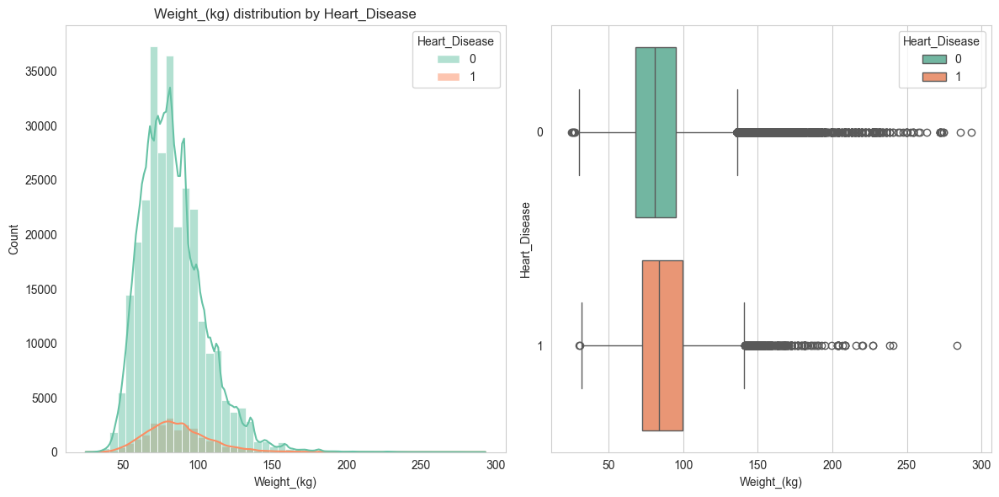

In [7]:
# VISUALIZATION 3: NUMERICAL VARS DISTRIBUTION HEART DISEASE/NO HEART DISEASE
trg = 'Heart_Disease'
color = 'Set2'
for col in numeric_cols:
    fig, axes = plt.subplots(1, 2, figsize=(12,6))

    sns.histplot(data=df, x=df[col], hue=trg, bins=50, kde=True, palette=color, ax=axes[0])
    axes[0].set_title(f'{col} distribution by {trg}')
    axes[0].grid(False)

    sns.boxplot(
        data=df, x=col, y=trg,
        hue=trg, palette=color,
        ax=axes[1], orient='h'
    )

plt.tight_layout()
plt.show()

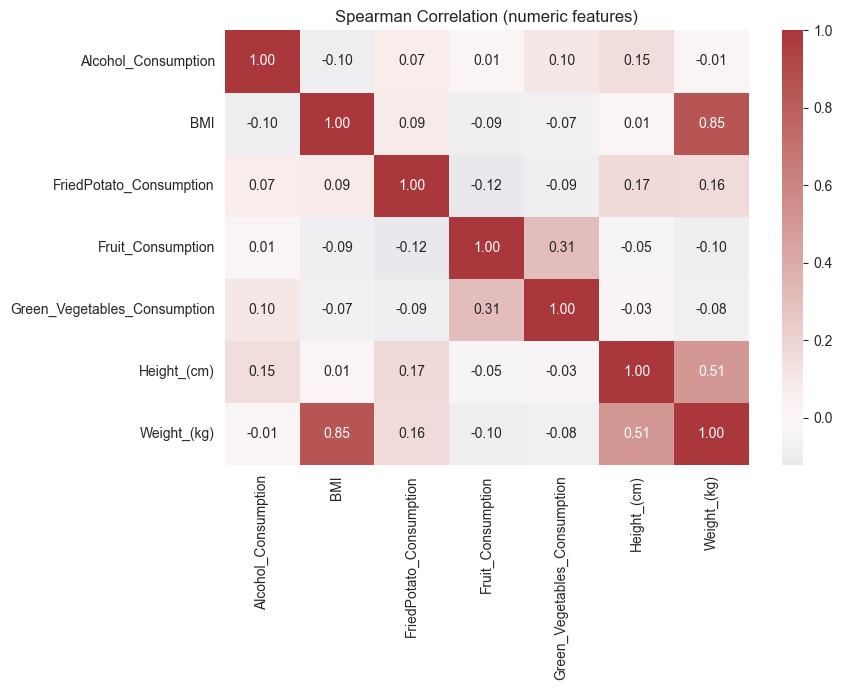

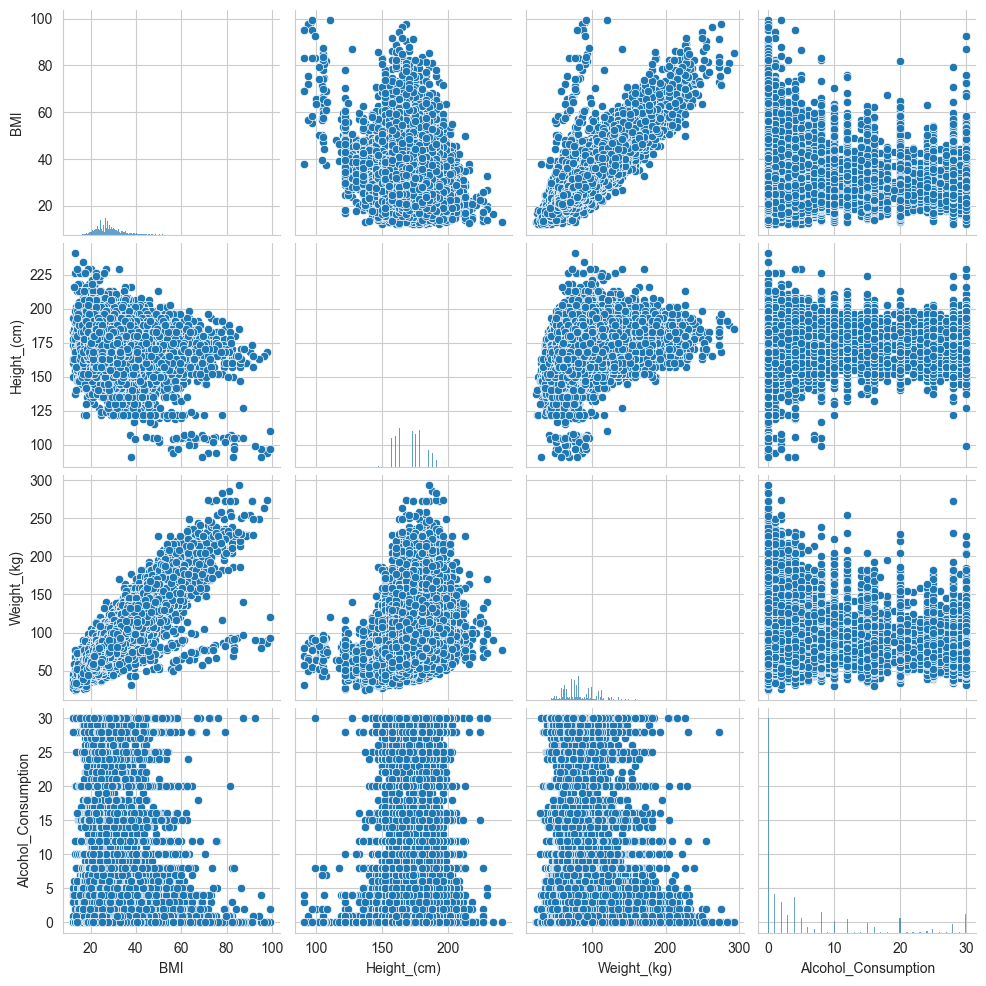

In [8]:
# MULTIVARIATE ANALYSIS
# M1 Correlation analysis (numeric)

# Correlation matrix
num_for_corr = [c for c in numeric_cols if c in df.columns]
corr = df[num_for_corr].corr(method='spearman')
plt.figure(figsize=(9,7))
sns.heatmap(corr, annot=True, fmt='.2f', cmap='vlag', center=0)
plt.title('Spearman Correlation (numeric features)')
plt.tight_layout()

# Pairplot for a selected subset
subset = [c for c in ['BMI','Height_(cm)','Weight_(kg)','Alcohol_Consumption'] if c in df.columns]
if len(subset) >= 2:
    sns.pairplot(df[subset].dropna())

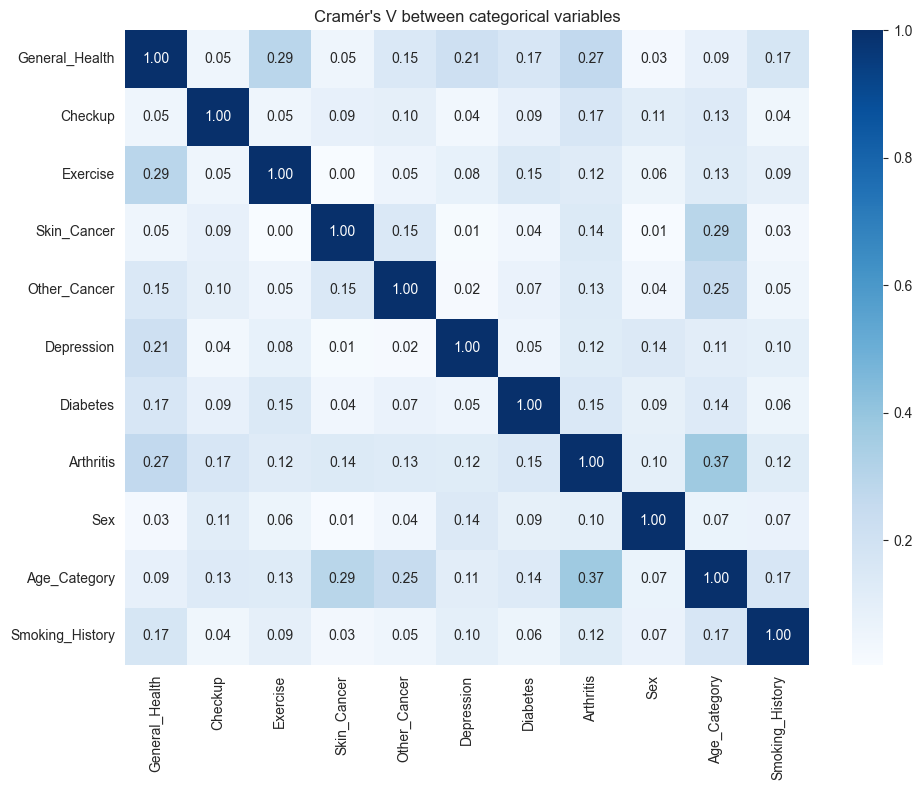

In [9]:
# M2 Multivariate analysis between categorical variables (Cramér's V)

from scipy.stats import chi2_contingency

def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x, y)
    if confusion_matrix.size == 0:
        return np.nan
    chi2 = chi2_contingency(confusion_matrix, correction=False)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    # bias correction
    phi2corr = max(0, phi2 - ((k-1)*(r-1))/(n-1))
    rcorr = r - ((r-1)**2)/(n-1)
    kcorr = k - ((k-1)**2)/(n-1)
    denom = min((kcorr-1), (rcorr-1))
    if denom == 0:
        return 0.0
    return np.sqrt(phi2corr/denom)

# Identify categorical columns for Cramér's V
cat_candidates = [c for c in df.columns if df[c].dtype == 'object' or c in ['Exercise','General_Health','Sex','Checkup']]
cat_candidates = [c for c in cat_candidates if c in df.columns]

cramers = pd.DataFrame(index=cat_candidates, columns=cat_candidates, dtype=float)
for a in cat_candidates:
    for b in cat_candidates:
        cramers.loc[a,b] = cramers_v(df[a].fillna('NA'), df[b].fillna('NA'))

plt.figure(figsize=(10,8))
sns.heatmap(cramers.astype(float), annot=True, fmt='.2f', cmap='Blues')
plt.title("Cramér's V between categorical variables")
plt.tight_layout()

In [11]:
# PARALLEL COORDINATES PLOT
# well i did something with chatGPT:D if you like it or want to try to improve and include it go ahead
# Prepare data for parallel coordinates
ordered_axis_groups = [

    # Body composition
    'BMI', 'Weight_(kg)',  'Height_(cm)',

    # Lifestyle
    'Exercise', 'Alcohol_Consumption',
    'Fruit_Consumption',
    # 'Green_Vegetables_Consumption',
    'FriedPotato_Consumption',

    'General_Health',

    # Target (always last)
    'Heart_Disease'
]

# Only keep columns that exist in df
pc_cols = [c for c in ordered_axis_groups if c in df.columns]
pc_df = df[pc_cols].copy()
pc_df = pc_df.dropna()


# Encode booleans as int if needed
for c in pc_df.columns:
    if pc_df[c].dtype == bool:
        pc_df[c] = pc_df[c].astype(int)

# Normalize numeric columns for better visualization
num_pc = [c for c in pc_cols if c in pc_df.columns and pd.api.types.is_numeric_dtype(pc_df[c])]
sc = StandardScaler()
if num_pc:
    pc_df[num_pc] = sc.fit_transform(pc_df[num_pc])

# If Heart_Disease present, color by it
if 'Heart_Disease' in pc_df.columns:
    pc_df['Heart_Disease_label'] = pc_df['Heart_Disease'].map({1:'CVD', 0:'No CVD'})
    color = 'Heart_Disease_label'
else:
    color = None

# Use Plotly Express for interactive parallel coordinates
if not pc_df.empty:
    fig = px.parallel_coordinates(pc_df, dimensions=num_pc + [c for c in pc_cols if c not in num_pc], color=pc_df['Heart_Disease'] if 'Heart_Disease' in pc_df.columns else None,
                                  labels={col:col for col in pc_df.columns}, color_continuous_scale=px.colors.diverging.Tealrose)
    fig.show()
